In [1]:
import os
import pickle

import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import plotnine
from plotnine import *

import anndata as ad
import scanpy as sc
import cell2location
from cell2location.utils import select_slide
from cell2location.utils.filtering import filter_genes
from cell2location.plt import plot_spatial
from cell2location.models import RegressionModel, Cell2location
import scvi
import pyro.optim

%matplotlib inline

import sys
sys.path.insert(0, "..")
from plot_settings import *
from spatial_correlation import FullRandomEffectsModel

Global seed set to 0


In [2]:
results_folder = "cell2location_results"
ref_run_name = os.path.join(results_folder, "reference_signatures")
run_name = os.path.join(results_folder, "cell2location_map")

In [3]:
adata_ref_nuc = ad.read_h5ad(
    "../../adata_nuclei_Celltype_subclustered.h5ad"
).raw.to_adata()
adata_ref_pdx = ad.read_h5ad("../../PDX_Celltype_scanpy.h5ad").raw.to_adata()

In [4]:
for ref in (adata_ref_nuc, adata_ref_pdx):
    ref.X.data = np.exp(ref.X.data) - 1
    ref.X = ref.X.multiply(ref.obs.total_counts.to_numpy()[:, np.newaxis]).tocsr()
    ref.X.data = np.round(ref.X.data / 1e4)
adata_ref_nuc = adata_ref_nuc[:, ~adata_ref_nuc.var_names.str.startswith("MT-")]
adata_ref_pdx = adata_ref_pdx[:, ~adata_ref_pdx.var_names.str.startswith("MT-")]

In [5]:
adata_ref = ad.concat(
    {"nuclei": adata_ref_nuc, "pdx": adata_ref_pdx},
    label="dataset",
    index_unique="_",
    merge=None,
    join="outer",
)

/home/kats/.local/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10


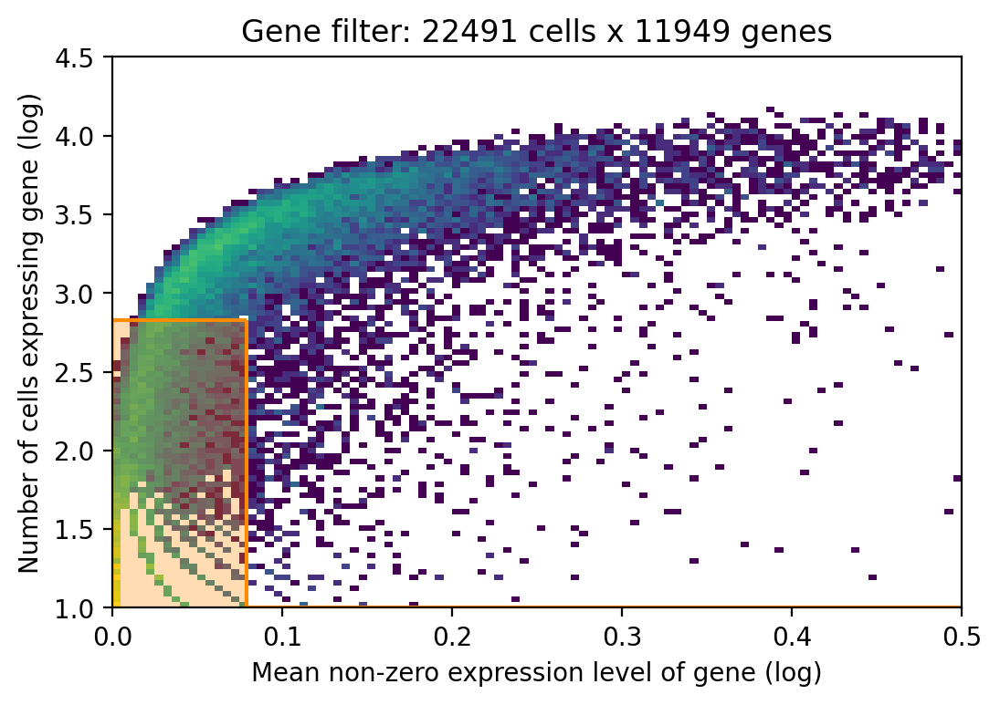

In [6]:
with mpl.rc_context({"figure.dpi": 200}):
    selected = filter_genes(
        adata_ref, cell_count_cutoff=10, cell_percentage_cutoff2=0.03, nonz_mean_cutoff=1.2
    )

In [7]:
adata_ref = adata_ref[:, selected].copy()

In [10]:
RegressionModel.setup_anndata(
    adata=adata_ref,
    batch_key="batch",
    labels_key="Cell_types",
    categorical_covariate_keys=["dataset"],
)

mod = RegressionModel(adata_ref)
mod.view_anndata_setup()

Anndata setup with scvi-tools version 0.16.2.

Setup via `RegressionModel.setup_anndata` with arguments:

{
│   'layer': None,
│   'batch_key': 'batch',
│   'labels_key': 'Cell_types',
│   'categorical_covariate_keys': ['dataset'],
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_cells          │ 22491 │
│          n_vars          │ 11949 │
│         n_batch          │   4   │
│         n_labels         │  17   │
│ n_extra_categorical_covs │   1   │
│ n_extra_continuous_covs  │   0   │
└──────────────────────────┴───────┘

                             Data Registry                             
┏━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Registry Key      ┃            scvi-tools Location             ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│           X            │                  adata.X                   │
│         batch          │          adata.obs['_scvi_batch']          │
│         labels         │         adata.obs['_scvi_labels']          │
│ extra_categorical_covs │ adata.obsm['_scvi_extra_categorical_covs'] │
│         ind_x          │           adata.obs['_indices']            │
└────────────────────────┴────────────────────────────────────────────┘

                  batch State Registry                   
┏━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃  Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['batch'] │     0      │          0          │
│                    │     1      │          1          │
│                    │     2      │          2          │
│                    │     3      │          3          │
└────────────────────┴────────────┴─────────────────────┘

                                labels State Registry                                 
┏━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃     Source Location     ┃             Categories             ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['Cell_types'] │       Anti-Tumor Macrophages       │          0          │
│                         │             Astrocytes             │          1          │
│                         │         Endothelial Cells          │          2          │
│                         │           Granule Cells            │          3          │
│                         │            Macrophages             │          4          │
│                         │       Malignant Basal State        │          5          │
│                         │         Malignant Cycling          │          6          │
│                         │ Malignant Granule-like Progenitor  │          7          │
│                         │  Malignant Neuronal Development I  │          8          │
│                         │ Malignant Neuronal Development II  │          9          │
│                         │ Malignant Neuronal Development III │         10          │
│                         │          Malignant SHH I           │         11          │
│                         │          Malignant SHH II          │         12          │
│                         │           Meninge Cells            │         13          │
│                         │             Microglia              │         14          │
│                         │       Pro-Tumor Macrophages        │         15          │
│                         │           Purkinje Cells           │         16          │
└─────────────────────────┴────────────────────────────────────┴─────────────────────┘

           extra_categorical_covs State Registry           
┏━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃   Source Location    ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['dataset'] │   nuclei   │          0          │
│                      │    pdx     │          1          │
│                      │            │                     │
└──────────────────────┴────────────┴─────────────────────┘

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/configuration_validator.py:120: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/data_loading.py:432: UserWarning: The number of training samples (5) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Epoch 1200/1200: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1200/1200 [19:11<00:00,  1.04it/s, v_num=1, elbo_train=1.11e+8]


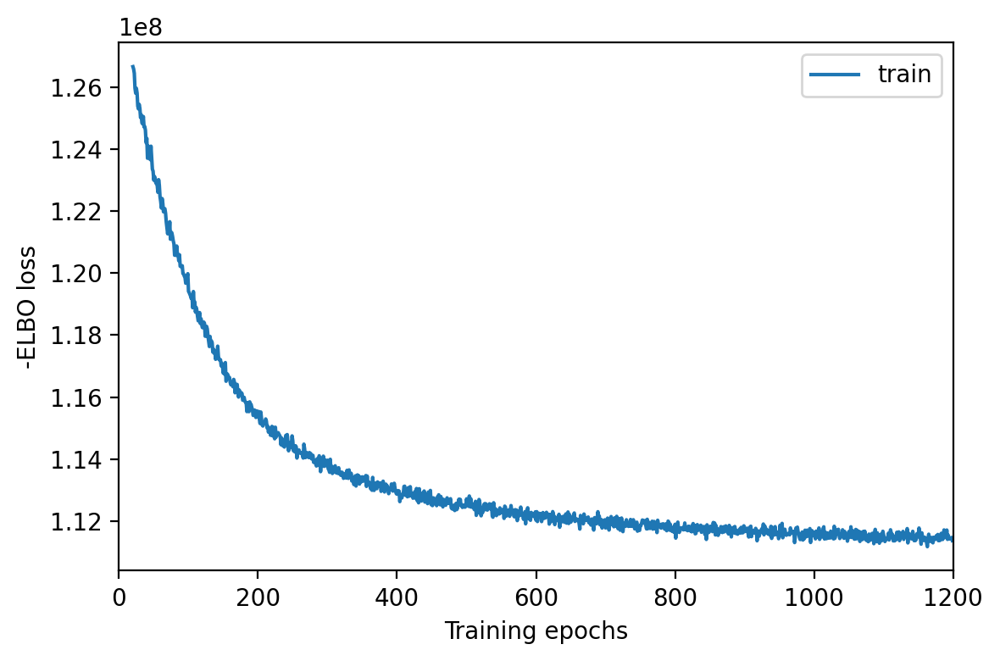

In [11]:
mod.train(max_epochs=1200, batch_size=5000, train_size=1, lr=0.001, use_gpu=True)
with mpl.rc_context({"figure.dpi": 200}):
    mod.plot_history(20)

In [12]:
mod.save(ref_run_name, overwrite=True)

In [13]:
adata_ref = mod.export_posterior(
    adata_ref, sample_kwargs={"num_samples": 10000, "batch_size": 5000, "use_gpu": True}
)
adata_ref.write(
    os.path.join(ref_run_name, "sc.h5ad"), compression="gzip", compression_opts=9
)

Sampling global variables, sample: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9999/9999 [02:19<00:00, 71.42it/s]


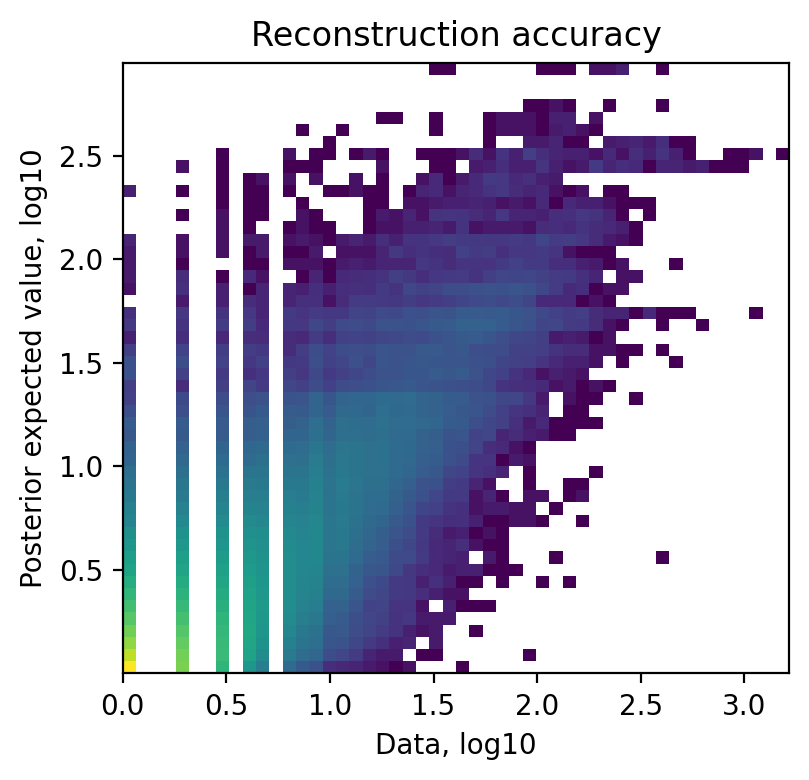

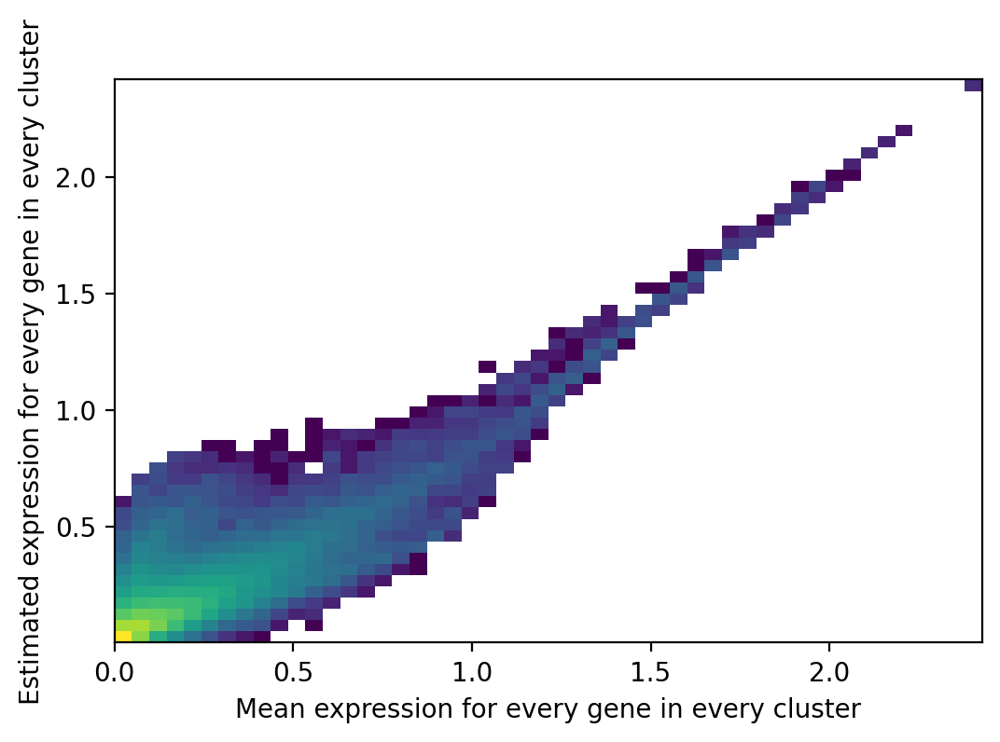

In [14]:
with mpl.rc_context({"figure.dpi": 200}):
    mod.plot_QC()

In [3]:
adata_ref = ad.read_h5ad(os.path.join(ref_run_name, "sc.h5ad"))

In [15]:
adatas = {}
for f in os.scandir("adatas/human/"):
    adatas[os.path.splitext(f.name)[0]] = ad.read_h5ad(f.path)

In [16]:
adata_vis = ad.concat(
    adatas, label="sample", merge="same", uns_merge="unique", index_unique="_"
)
adata_vis.var["mt"] = adata_vis.var_names.str.startswith("MT-")

In [17]:
adata_vis = adata_vis[:, ~adata_vis.var["mt"].to_numpy()]

inf_aver = adata_ref.varm["means_per_cluster_mu_fg"][
    [f"means_per_cluster_mu_fg_{i}" for i in adata_ref.uns["mod"]["factor_names"]]
]
inf_aver.columns = adata_ref.uns["mod"]["factor_names"]

intersect = adata_ref.var_names.intersection(adata_vis.var_names)

adata_vis = adata_vis[:, intersect].copy()
inf_aver = inf_aver.loc[intersect, :]
Cell2location.setup_anndata(adata_vis, batch_key="sample", layer="counts")

In [18]:
mod = Cell2location(
    adata_vis, cell_state_df=inf_aver, N_cells_per_location=30, detection_alpha=200
)
mod.view_anndata_setup()

Anndata setup with scvi-tools version 0.16.2.

Setup via `Cell2location.setup_anndata` with arguments:

{
│   'layer': 'counts',
│   'batch_key': 'sample',
│   'labels_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_cells          │ 12121 │
│          n_vars          │ 5375  │
│         n_batch          │  12   │
│         n_labels         │   1   │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │  adata.layers['counts']   │
│    batch     │ adata.obs['_scvi_batch']  │
│    labels    │ adata.obs['_scvi_labels'] │
│    ind_x     │   adata.obs['_indices']   │
└──────────────┴───────────────────────────┘

                   batch State Registry                   
┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃   Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['sample'] │ sample1.3  │          0          │
│                     │ sample3.2  │          1          │
│                     │ sample2.4  │          2          │
│                     │ sample2.1  │          3          │
│                     │ sample1.1  │          4          │
│                     │ sample1.4  │          5          │
│                     │ sample1.2  │          6          │
│                     │ sample2.3  │          7          │
│                     │ sample3.1  │          8          │
│                     │ sample3.4  │          9          │
│                     │ sample3.3  │         10          │
│                     │ sample2.2  │         11          │
└─────────────────────┴────────────┴─────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

In [19]:
from pyro.optim.optim import is_scheduler


class LRDTrainingPlan(scvi.train.PyroTrainingPlan):
    def training_epoch_end(self, outputs):
        super().training_epoch_end(outputs)
        if is_scheduler(self.optim):
            self.optim.step()

In [20]:
from pyro.optim import LinearLR
from torch.optim import Adam

start_lr = 0.002
end_lr = 0.0001
epochs = 40000
mod.train(
    max_epochs=epochs,
    batch_size=10000,
    train_size=1,
    training_plan=LRDTrainingPlan,
    plan_kwargs={
        "optim": LinearLR(
            {
                "optimizer": Adam,
                "optim_args": {"lr": start_lr},
                "start_factor": 1,
                "end_factor": end_lr / start_lr,
                "total_iters": epochs,
            }
        )
    },
    use_gpu=True,
)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/configuration_validator.py:120: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/data_loading.py:432: UserWarning: The number of training samples (2) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Epoch 19978/40000:  50%|█████████████████████████████████████████████████████▍                                                     | 19977/40000 [2:03:23<1:54:09,  2.92it/s, v_num=1, elbo_train=8.28e+7]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Epoch 25235/40000:  63%|███████████████████████████████████████████████████████████████████▌                                       | 25234/40000 [2:33:09<1:26:15,  2.85it/s, v_num=1, elbo_train=8.25e+7]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Epoch 30316/40000:  76%|██████████████████████████████████████████████████████████████████████████████████▌                          | 30316/40000 [3:02:00<56:37,  2.85it/s, v_num=1, elbo_train=8.22e+7]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Epoch 35529/40000:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▊            | 35529/40000 [3:31:45<24:47,  3.01it/s, v_num=1, elbo_train=8.22e+7]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Epoch 40000/40000: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40000/40000 [3:57:12<00:00,  2.81it/s, v_num=1, elbo_train=8.17e+7]


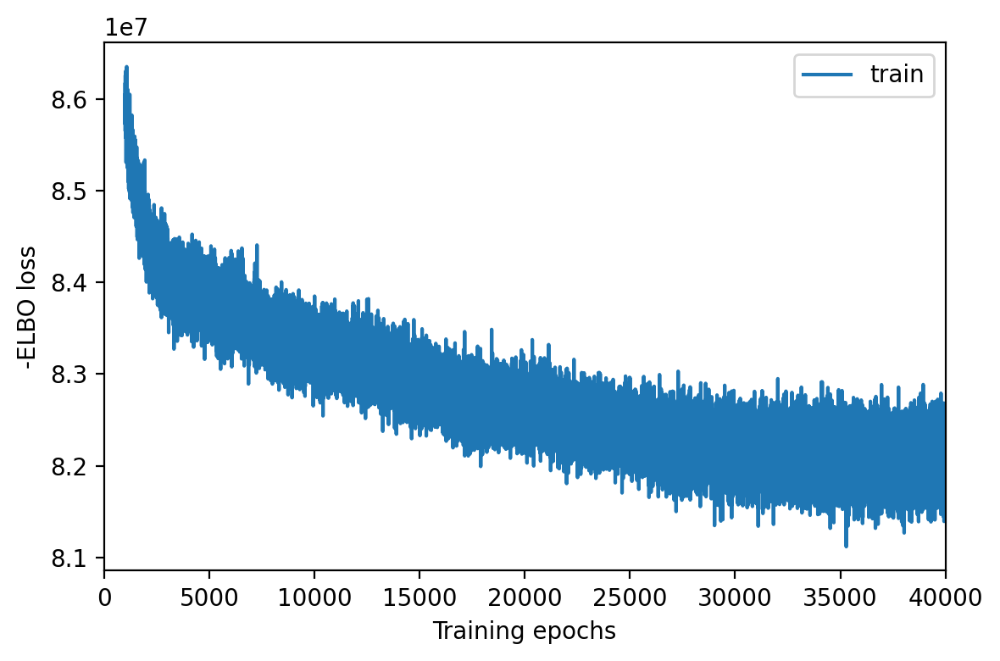

In [21]:
with mpl.rc_context({"figure.dpi": 200}):
    mod.plot_history(1000)

In [22]:
mod.save(run_name, overwrite=True)

In [8]:
mod = Cell2location.load(run_name, adata_vis, use_gpu=False)

INFO     File cell2location/mouse_model/model.pt already downloaded                          
INFO     Preparing underlying module for load                                                


GPU available: True, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/trainer.py:1584: UserWarning: GPU available but not used. Set the gpus flag in your trainer `Trainer(gpus=1)` or script `--gpus=1`.
  rank_zero_warn(
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/configuration_validator.py:120: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/data_loading.py:432: UserWarning: The number of training samples (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
  rank_zero_warn(


Epoch 1/30000:   0%|                                                                                                                    | 1/30000 [00:02<22:57:17,  2.75s/it, v_num=1, elbo_train=1.27e+8]


In [23]:
adata_vis = mod.export_posterior(
    adata_vis, sample_kwargs={"num_samples": 8000, "batch_size": 10000, "use_gpu": True}
)
adata_vis.write_h5ad(
    os.path.join(run_name, "sp.h5ad"), compression="gzip", compression_opts=9
)

Sampling global variables, sample: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7999/7999 [01:54<00:00, 69.81it/s]


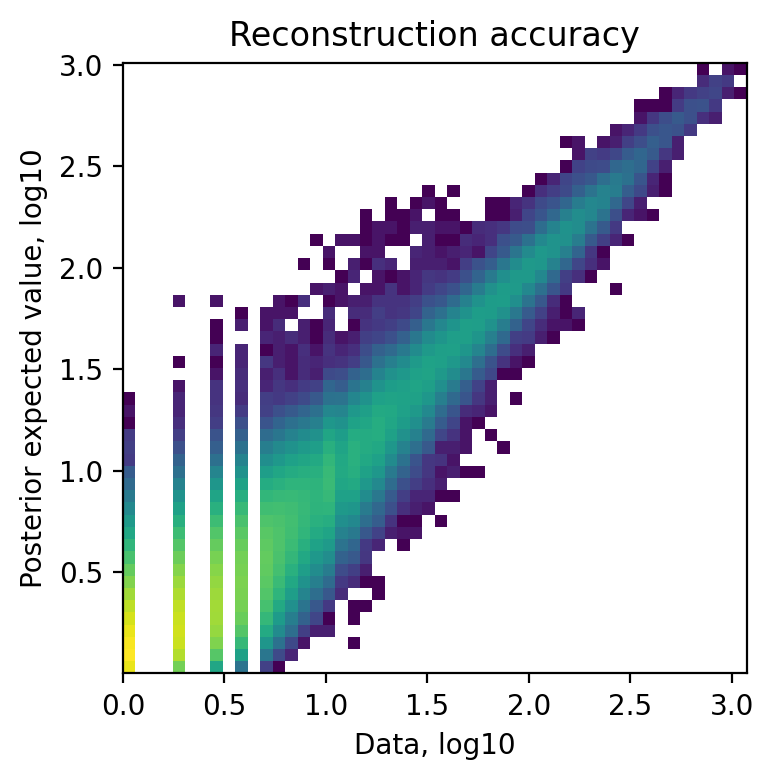

In [24]:
with mpl.rc_context({"figure.dpi": 200}):
    mod.plot_QC()

In [3]:
adata_vis = ad.read_h5ad(os.path.join(run_name, "sp.h5ad"))

In [4]:
adata_vis.uns["mod"]["factor_names"][
    adata_vis.uns["mod"]["factor_names"] == "Granule Cells"
] = "Granule-like Cells"

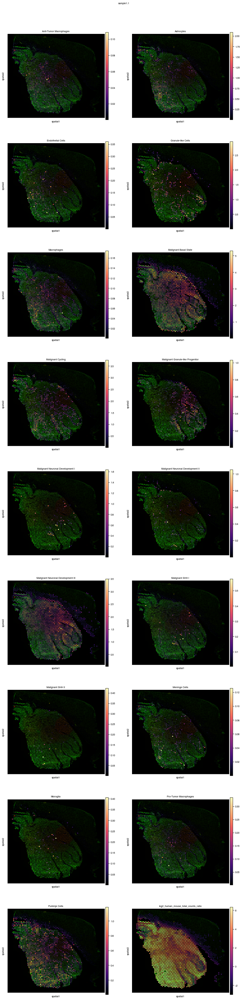

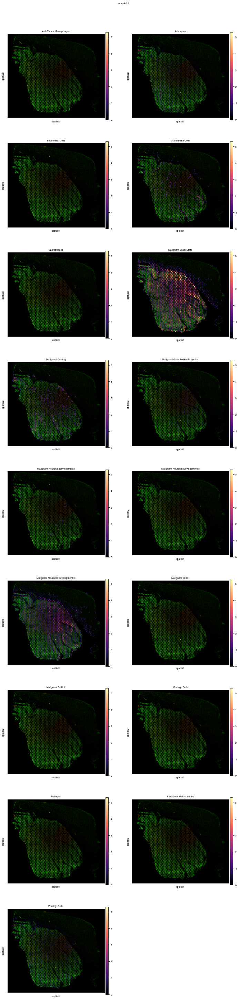

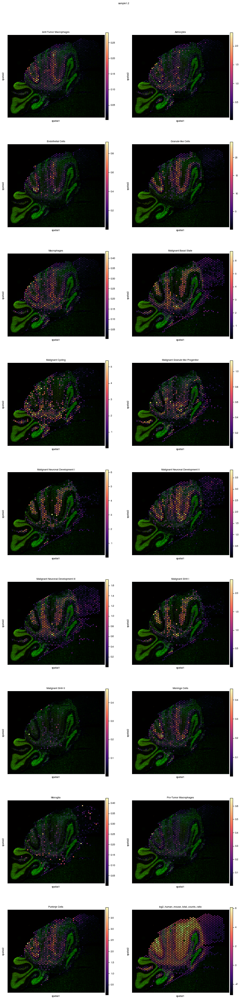

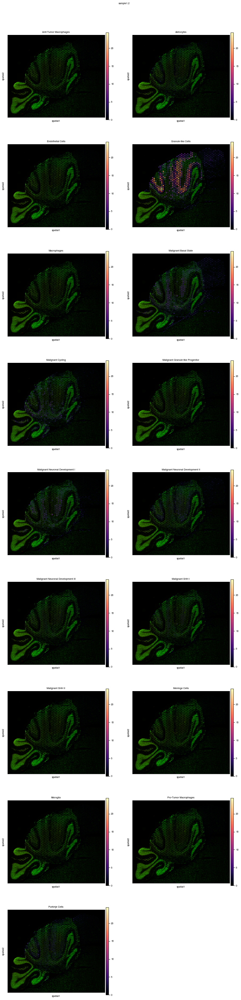

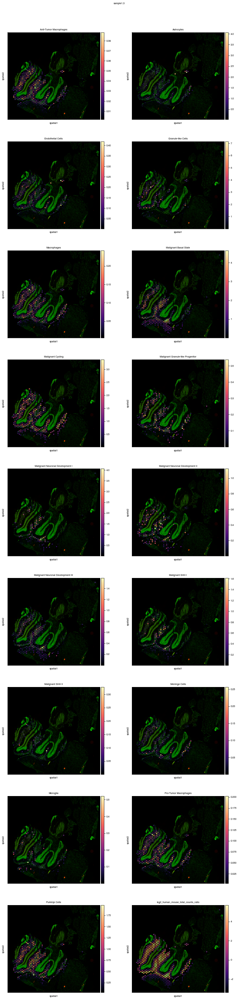

...

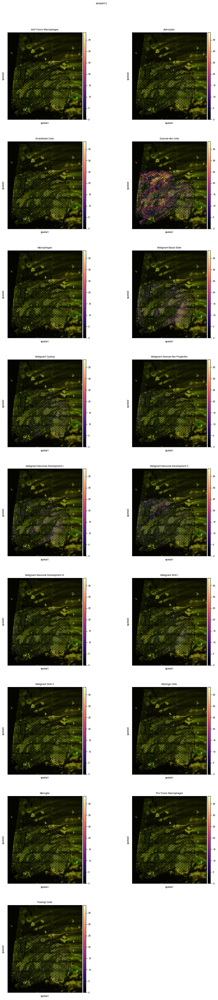

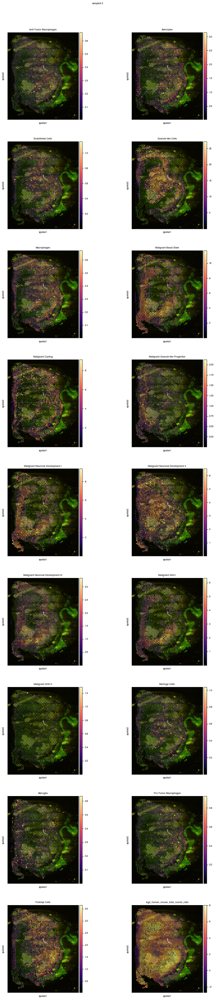

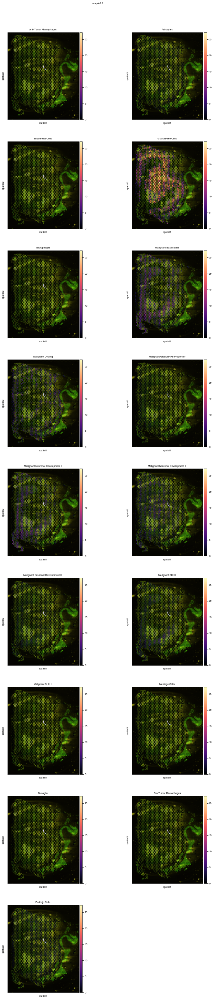

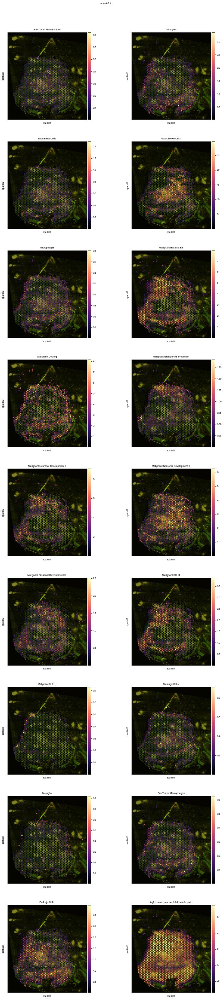

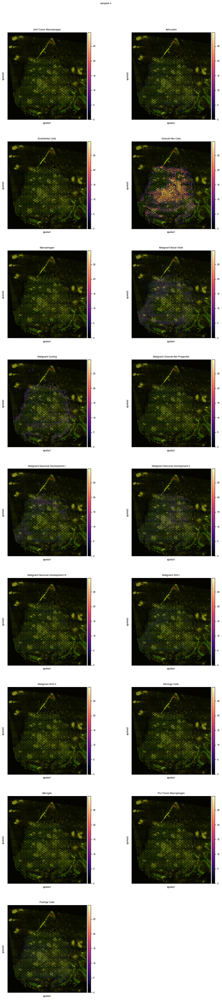

In [5]:
adata_vis.obs[adata_vis.uns["mod"]["factor_names"]] = adata_vis.obsm[
    "q05_cell_abundance_w_sf"
]
toplot = list(adata_vis.uns["mod"]["factor_names"])

for sample in sorted(adata_vis.uns["spatial"].keys()):
    slide = select_slide(adata_vis, sample)

    with mpl.rc_context({"figure.figsize": [5, 5]}):
        sc.pl.spatial(
            slide,
            cmap="magma",
            color=toplot + ["log2_human_mouse_total_counts_ratio"],
            ncols=2,
            show=False,
        )
        plt.suptitle(sample, y=0.9)
        plt.show()

        vmax = slide.obs[toplot].max().max()
        sc.pl.spatial(
            slide, cmap="magma", color=toplot, ncols=2, show=False, vmin=0, vmax=vmax
        )
        plt.suptitle(sample, y=0.9)
        plt.show()

In [6]:
adata_vis.obs[adata_vis.uns["mod"]["factor_names"]] = adata_vis.obsm[
    "q05_cell_abundance_w_sf"
].div(adata_vis.obsm["q05_cell_abundance_w_sf"].sum(1), axis=0)

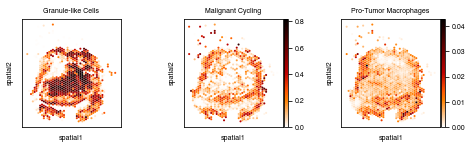

In [7]:
with mpl.rc_context({"figure.figsize": (8, 2)}):
    slide = select_slide(adata_vis, "sample3.4")
    fig, ax = plt.subplots(1, 3)
    celltypes = ["Granule-like Cells", "Malignant Cycling", "Pro-Tumor Macrophages"]
    vmax = slide.obs[celltypes].max().max()
    for i, ct in enumerate(celltypes):
        cbarloc = "right" if i >= 1 else None
        if i > 1:
            vmax = None
        sc.pl.spatial(
            slide,
            cmap=mpl.cm.get_cmap("gist_heat").reversed(),
            img_key=None,
            size=1.5,
            color=ct,
            vmin=0,
            vmax=vmax,
            ax=ax[i],
            colorbar_loc=cbarloc,
            title=ct,
            show=False
        )
    plt.savefig(f"figures/6A_c2l.svgz")
    plt.show()

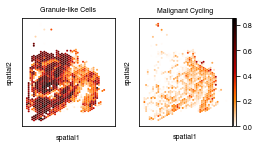

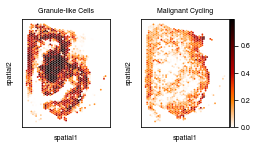

In [8]:
with mpl.rc_context({"figure.figsize": (4, 2)}):
    for sample in ("3.2", "3.3"):
        slide = select_slide(adata_vis, f"sample{sample}")
        fig, ax = plt.subplots(1, 2)
        celltypes = ["Granule-like Cells", "Malignant Cycling"]
        vmax = slide.obs[celltypes].max().max()
        for i, ct in enumerate(celltypes):
            cbarloc = "right" if i >= 1 else None
            if i > 1:
                vmax = None
            sc.pl.spatial(
                slide,
                cmap=mpl.cm.get_cmap("gist_heat").reversed(),
                img_key=None,
                size=1.5,
                color=ct,
                vmin=0,
                vmax=vmax,
                ax=ax[i],
                colorbar_loc=cbarloc,
                title=ct,
                show=False
            )
        plt.savefig(f"figures/S17_c2l_{sample}.svgz")
        plt.show()

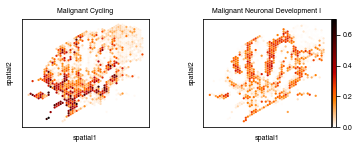

In [9]:
with mpl.rc_context({"figure.figsize": (6, 2)}):
    slide = select_slide(adata_vis, "sample1.2")
    fig, ax = plt.subplots(1, 2)
    celltypes = ["Malignant Cycling", "Malignant Neuronal Development I"]
    vmax = slide.obs[celltypes].max().max()
    for i, ct in enumerate(celltypes):
        cbarloc = "right" if i >= 1 else None
        if i > 1:
            vmax = None
        sc.pl.spatial(
            slide,
            cmap=mpl.cm.get_cmap("gist_heat").reversed(),
            img_key=None,
            size=1.5,
            color=ct,
            vmin=0,
            vmax=vmax,
            ax=ax[i],
            colorbar_loc=cbarloc,
            title=ct,
            show=False
        )
    plt.savefig(f"figures/S15.svgz")
    plt.show()

In [10]:
timepointmap = {
    "sample1.1": "pre-treatment",
    "sample1.2": "pre-treatment",
    "sample1.3": "MRD",
    "sample1.4": "regrown",
    "sample2.1": "early effect",
    "sample2.2": "early effect",
    "sample2.3": "early effect",
    "sample2.4": "MRD",
    "sample3.1": "pre-treatment",
    "sample3.2": "regrown",
    "sample3.3": "regrown",
    "sample3.4": "regrown",
}

adata_vis.obs["dominant_region_celltype"] = pd.Categorical(
    np.asarray(adata_vis.uns["mod"]["factor_names"])[
        adata_vis.obsm["q05_cell_abundance_w_sf"].to_numpy().argmax(1)
    ]
)

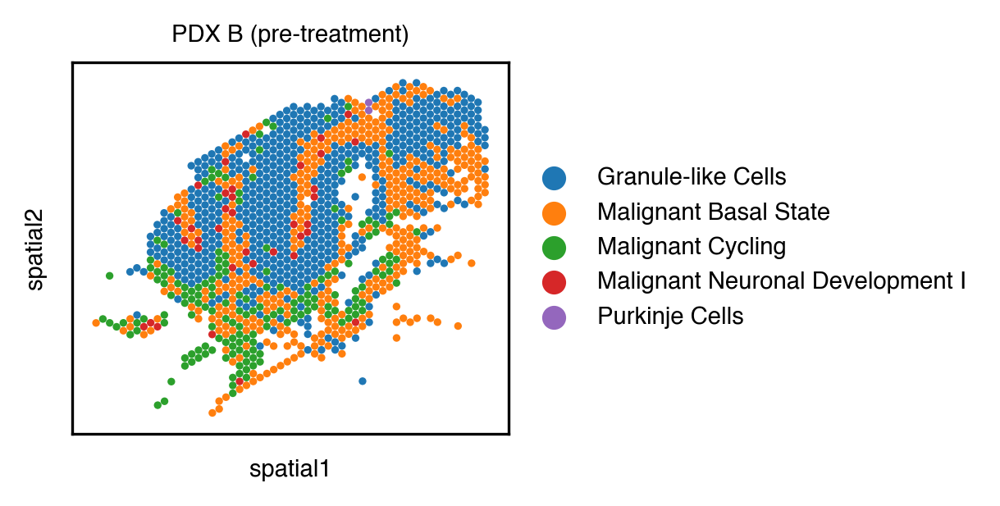

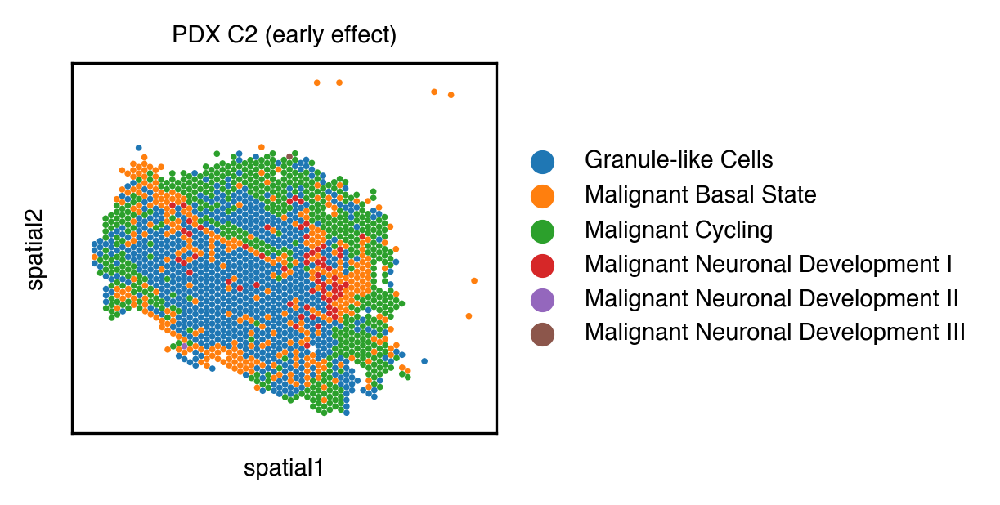

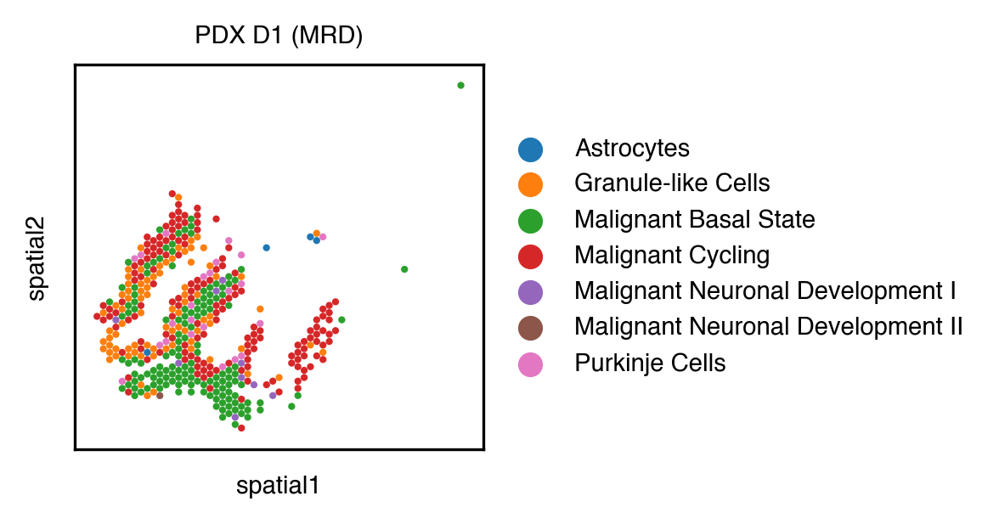

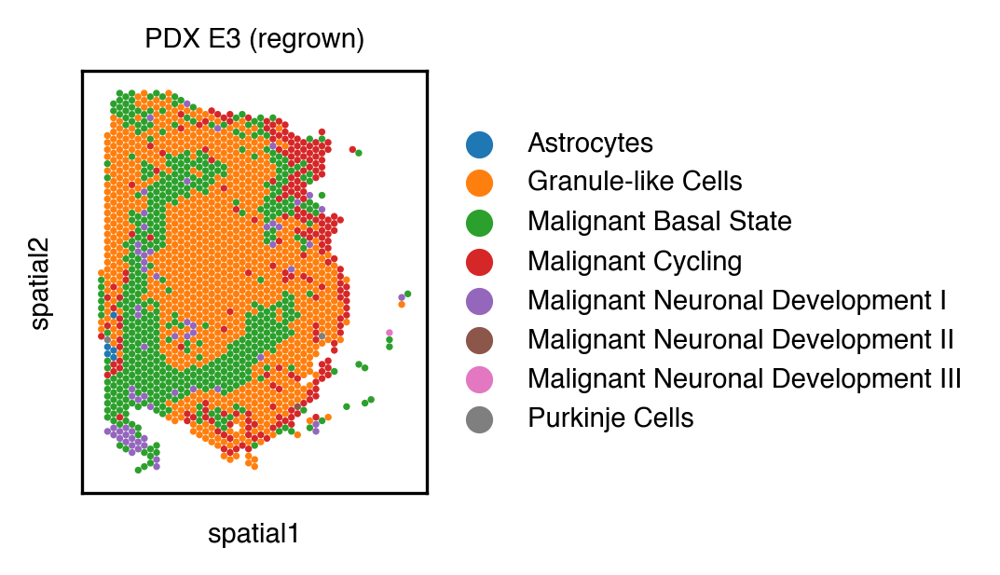

In [11]:
with mpl.rc_context({"figure.figsize": (6, 2), "figure.dpi": 300}):
    for sample in ("1.2", "2.2", "1.3", "3.3"):
        slide = select_slide(adata_vis, "sample" + sample)

        sc.pl.spatial(
            slide,
            title=f"{pdx_sample_map[sample]} ({timepointmap['sample' + sample]})",
            color="dominant_region_celltype",
            img_key=None,
            size=1.5,
            show=False,
        )
        plt.savefig(f"figures/6D_{sample}.svgz")

In [4]:
import tensorflow as tf
import gpflow

In [5]:
fake_adatas = {}
for sample in adata_vis.obs["sample"].cat.categories:
    cadata_vis = adata_vis[adata_vis.obs["sample"] == sample]
    cadata = ad.AnnData(
        X=cadata_vis.obsm["q05_cell_abundance_w_sf"].to_numpy(),
        obs=pd.DataFrame(index=cadata_vis.obs_names),
        var=pd.DataFrame(
            index=cadata_vis.obsm["q05_cell_abundance_w_sf"].columns.str[23:]
        ),
        obsm={"spatial": cadata_vis.obsm["spatial"]},
        uns={"spatial": {sample: cadata_vis.uns["spatial"][sample]}},
        dtype=np.float64,
    )
    sc.pp.log1p(cadata)
    sc.pp.scale(cadata)
    fake_adatas[sample] = cadata

In [7]:
from scipy.spatial.distance import pdist, squareform

l_min = squareform(pdist(fake_adatas["sample1.1"].obsm["spatial"]))
np.fill_diagonal(l_min, np.inf)
l_min = l_min.min()
l_min

307.0

In [34]:
from collections import namedtuple

Result = namedtuple("Result", ("celltype1", "celltype2", "correlation", "lengthscale"))

In [ ]:
from tqdm.auto import tqdm

opt = gpflow.optimizers.Scipy()
results = {}
for sname, cadata in tqdm(fake_adatas.items()):
    cresults = []
    for i, ct1 in enumerate(tqdm(cadata.var_names)):
        for j, ct2 in enumerate(tqdm(cadata.var_names[(i + 1) :])):
            lmm = FullRandomEffectsModel(
                cadata[:, ct1].X, cadata[:, ct2].X, cadata.obsm["spatial"], 10 * l_min
            )
            opt.minimize(
                lambda: -lmm.loglik(),
                variables=lmm.trainable_vars("alt"),
                method="bfgs",
            )

            cresults.append(
                Result(
                    ct1,
                    ct2,
                    lmm.e[0, 0].numpy()
                    * lmm.e[1, 0].numpy()
                    / (
                        np.sqrt(lmm.e[0, 0].numpy() ** 2 + lmm.sigma[0] ** 2)
                        * np.sqrt(
                            lmm.e[1, 0].numpy() ** 2
                            + lmm.e[1, 1].numpy() ** 2
                            + lmm.sigma[1].numpy() ** 2
                        )
                    ),
                    lmm.kernel.lengthscales.numpy()[()],
                )
            )
    results[sname] = cresults

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

0it [00:00, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

0it [00:00, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

0it [00:00, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

0it [00:00, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

0it [00:00, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

0it [00:00, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

In [10]:
with open("celltypes_pairwise_spatial_correlations_human.pkl", "wb") as file:
    pickle.dump(results, file)

In [37]:
results = pickle.load(open("celltypes_pairwise_spatial_correlations_human.pkl", "rb"))

In [167]:
df = []
for sample, res in results.items():
    for cres in res:
        df.append(
            pd.DataFrame(
                {
                    "sample": sample,
                    "celltype1": [cres.celltype1, cres.celltype2],
                    "celltype2": [cres.celltype2, cres.celltype1],
                    "correlation": cres.correlation,
                    "lengthscale": cres.lengthscale,
                }
            )
        )
df = pd.concat(df).reset_index(drop=True)
df["sample"] = pd.Categorical(df["sample"])
df.celltype1 = pd.Categorical(df.celltype1)
df.celltype2 = pd.Categorical(df.celltype2)
df.to_feather("celltypes_pairwise_spatial_correlations.feather")

In [12]:
df = pd.read_feather("celltypes_pairwise_spatial_correlations.feather")

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 4 x 4 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/6A.svgz


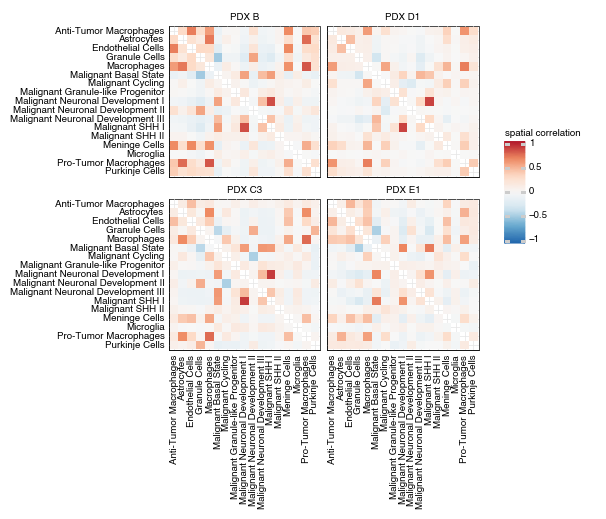

In [13]:
p = (
    ggplot(
        df[df["sample"].isin(("sample1.2", "sample1.3", "sample2.3", "sample3.4"))],
        aes("celltype1", "celltype2", fill="correlation"),
    )
    + geom_tile()
    + scale_y_discrete(limits=df.celltype2.cat.categories[::-1])
    + facet_wrap("sample", labeller = lambda x: pdx_sample_map[x[-3:]])
    + scale_fill_distiller(type="div", palette="RdBu", limits=(-1, 1), expand=(0, 0))
    + labs(x=None, y=None, fill="spatial correlation")
    + theme(
        aspect_ratio=1,
        figure_size=(4, 4),
        axis_text_x=element_text(rotation=90),
        axis_ticks=element_blank(),
    )
)
p.save("figures/6A.svgz")
print(p)

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 7.5 x 7.5 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S14.svgz


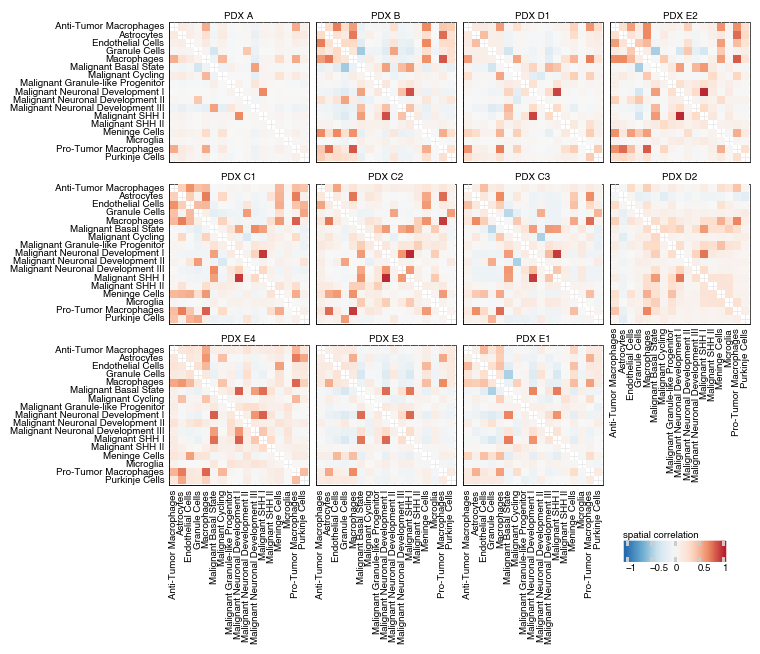

In [14]:
p = (
    ggplot(
        df[df["sample"] != "sample3.1"],
        aes("celltype1", "celltype2", fill="correlation"),
    )
    + geom_tile()
    + scale_y_discrete(limits=df.celltype2.cat.categories[::-1])
    + facet_wrap("sample", labeller = lambda x: pdx_sample_map[x[-3:]])
    + scale_fill_distiller(type="div", palette="RdBu", limits=(-1, 1), expand=(0, 0))
    + labs(x=None, y=None, fill="spatial correlation")
    + theme(
        aspect_ratio=1,
        figure_size=(7.5, 7.5),
        axis_text_x=element_text(rotation=90),
        axis_ticks=element_blank(),
        legend_direction="horizontal",
        legend_position=(0.8, 0)
    )
)
p.save("figures/S14.svgz")
print(p)

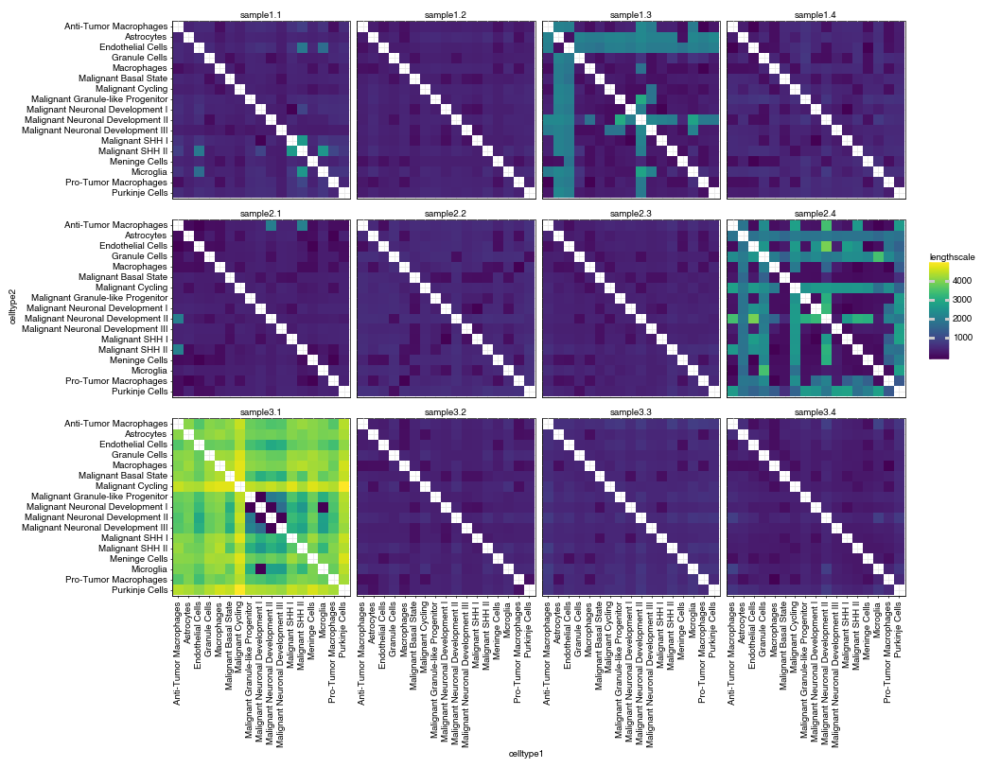

<ggplot: (8777526824084)>

In [15]:
(
    ggplot(df, aes("celltype1", "celltype2", fill="lengthscale"))
    + geom_tile()
    + scale_y_discrete(limits=df.celltype2.cat.categories[::-1])
    + facet_wrap("sample")
    + theme(aspect_ratio=1, figure_size=(10, 10), axis_text_x=element_text(rotation=90))
)

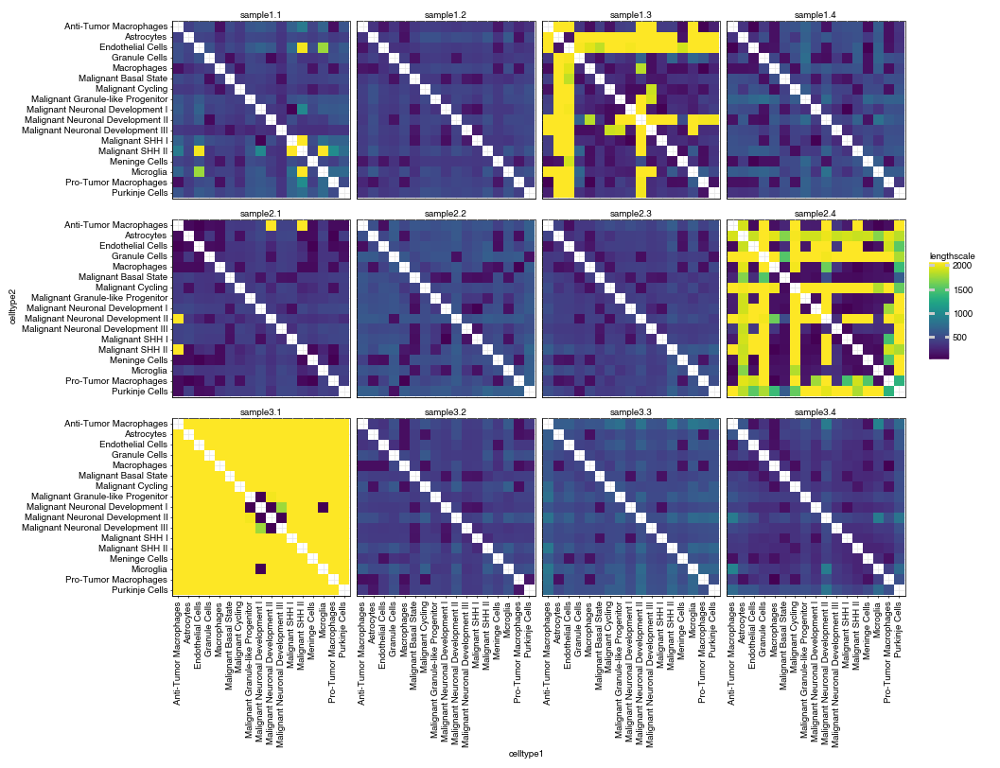

<ggplot: (8777477564275)>

In [16]:
(
    ggplot(df, aes("celltype1", "celltype2", fill="lengthscale"))
    + geom_tile()
    + scale_y_discrete(limits=df.celltype2.cat.categories[::-1])
    + lims(fill=(100, 2000))
    + facet_wrap("sample")
    + theme(aspect_ratio=1, figure_size=(10, 10), axis_text_x=element_text(rotation=90))
)

In [17]:
from scipy.stats import pearsonr, mannwhitneyu

In [18]:
df_ffpe = pd.read_feather("../human/celltypes_pairwise_spatial_correlations.feather")
dfs = []
for pdxsample in df["sample"].cat.categories:
    for ffpesample in df_ffpe["sample"].cat.categories:
        cdf_ffpe = df_ffpe[df_ffpe["sample"] == ffpesample].pivot(
            index="celltype1", columns="celltype2", values="correlation"
        )
        cdf_pdx = (
            df[df["sample"] == pdxsample]
            .pivot(index="celltype1", columns="celltype2", values="correlation")
            .reindex_like(cdf_ffpe)
        )

        corr = pearsonr(
            cdf_ffpe.to_numpy()[np.triu_indices(cdf_ffpe.shape[0], 1)],
            cdf_pdx.to_numpy()[np.triu_indices(cdf_pdx.shape[0], 1)],
        ).statistic
        dfs.append({"pdx": pdxsample, "ffpe": ffpesample, "corr": corr})

dfs = pd.DataFrame(dfs).assign(
    ffpe_type=lambda x: np.where(x.ffpe.str[0].astype(int) <= 3, "LFS", "sporadic")
)

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 2 x 2 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/SX_pdx_ffpe_correlation.svgz


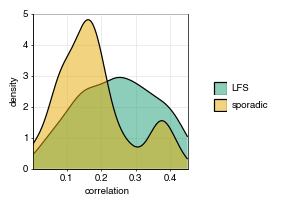

In [19]:
p = (
    ggplot(dfs, aes("corr", fill="ffpe_type"))
    + geom_density(alpha=0.5)
    + scale_x_continuous(expand=(0, 0))
    + scale_y_continuous(expand=(0, 0, 0.04, 0))
    + lfs_sporadic_fill_scale
    + labs(x="correlation", fill="")
    + theme(figure_size=(2,2), aspect_ratio=1)
)
p.save("figures/SX_pdx_ffpe_correlation.svgz")
print(p)

In [20]:
mannwhitneyu(dfs["corr"][dfs.ffpe_type == "LFS"], dfs["corr"][dfs.ffpe_type != "LFS"])

MannwhitneyuResult(statistic=3881.0, pvalue=0.00026783615484941424)

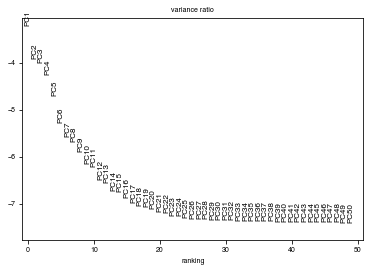

In [21]:
sc.tl.pca(adata_vis)
sc.pl.pca_variance_ratio(adata_vis, n_pcs=50, log=True)

In [22]:
sc.pp.neighbors(adata_vis, n_neighbors=15, n_pcs=20)
sc.tl.umap(adata_vis)

In [27]:
adata_vis.obs["treatment"] = pd.Categorical(
    adata_vis.obs["sample"].map(
        {
            "sample1.1": "control",
            "sample1.2": "control",
            "sample1.3": "carbon",
            "sample1.4": "carbon+PARPi",
            "sample2.1": "carbon",
            "sample2.2": "carbon",
            "sample2.3": "carbon",
            "sample2.4": "carbon+PARPi",
            "sample3.1": "control",
            "sample3.2": "carbon+PARPi",
            "sample3.3": "carbon+PARPi",
            "sample3.4": "carbon",
        }
    )
)

adata_vis.obs["timepoint_description"] = pd.Categorical(
    adata_vis.obs["sample"].map(timepointmap),
    categories=["pre-treatment", "early effect", "MRD", "regrown"],
    ordered=True,
)

In [22]:
adata_vis.obs["sample"] = adata_vis.obs["sample"].cat.reorder_categories(
    np.sort(adata_vis.obs["sample"].cat.categories)
)

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


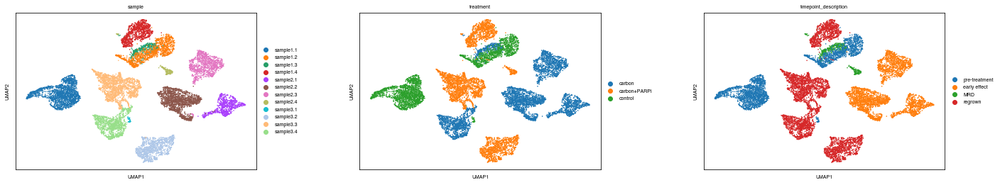

In [28]:
sc.pl.umap(
    adata_vis, color=["sample", "treatment", "timepoint_description"], wspace=0.3
)

In [15]:
from scvi.model import SCVI

SCVI.setup_anndata(adata_vis, layer="counts", batch_key="sample")
vae = SCVI(
    adata_vis, n_layers=1, n_latent=10, gene_likelihood="nb", dispersion="gene-batch"
)
vae.train(
    max_epochs=300,
    use_gpu=True,
    train_size=0.9,
    batch_size=10000,
    check_val_every_n_epoch=1,
)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/data_loading.py:432: UserWarning: The number of training samples (2) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Epoch 1/300:   0%|                                                                                                                                                                | 0/300 [00:00<?, ?it/s]

/home/kats/.local/lib/python3.10/site-packages/scvi/distributions/_negative_binomial.py:100: UserWarning: Specified kernel cache directory could not be created! This disables kernel caching. Specified directory is /home/kats/.cache/torch/kernels. This warning will appear only once per process. (Triggered internally at  ../aten/src/ATen/native/cuda/jit_utils.cpp:860.)


Epoch 300/300: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 300/300 [02:21<00:00,  2.13it/s, loss=7.36e+03, v_num=1]


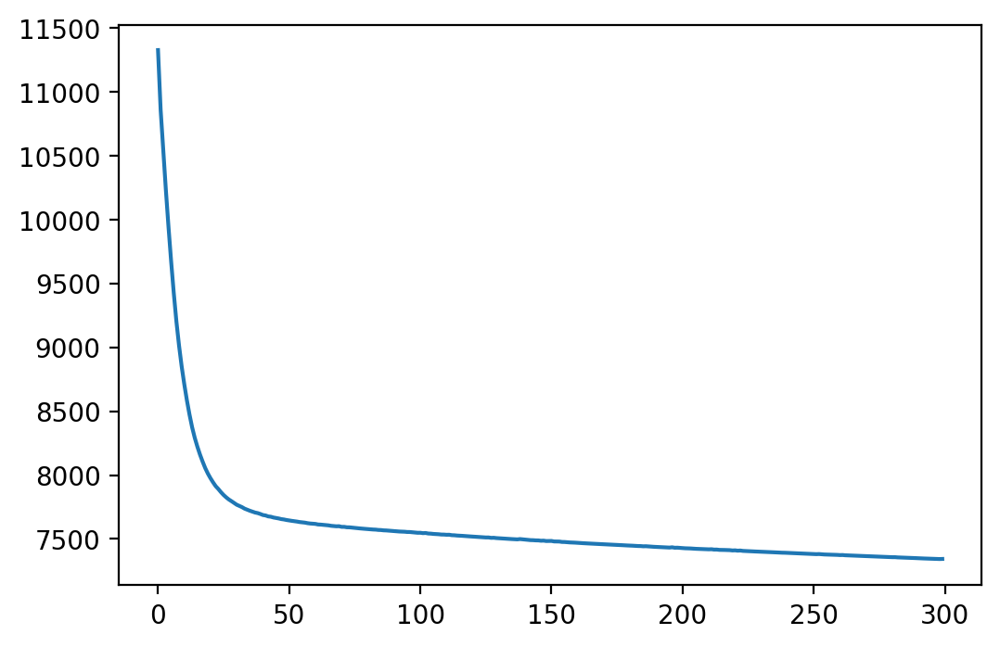

In [16]:
plt.plot(vae.history["elbo_train"])

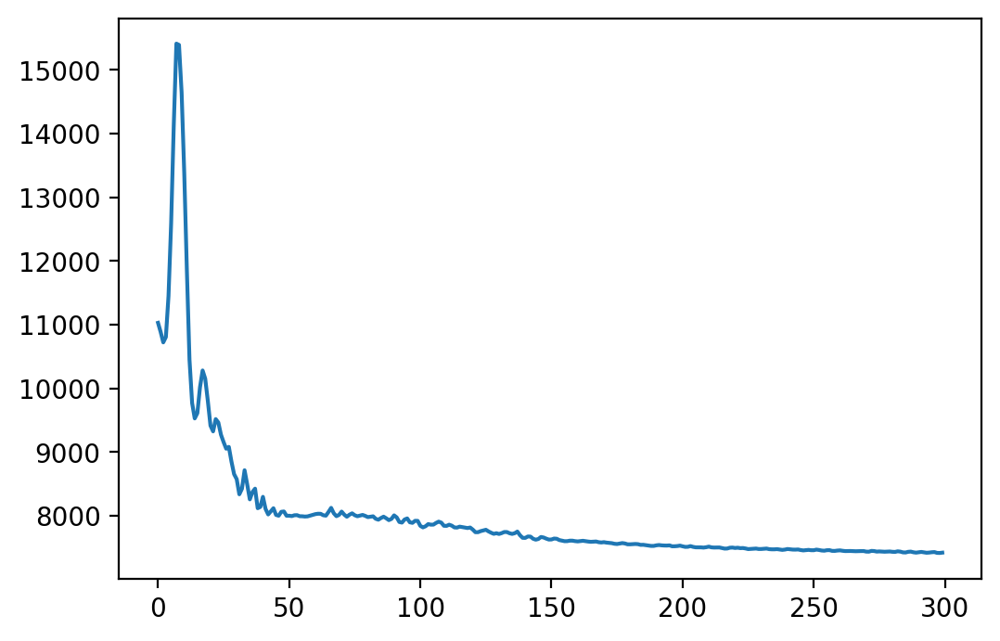

In [17]:
plt.plot(vae.history["elbo_validation"])

In [23]:
adata_vis.obsm["X_scVI"] = vae.get_latent_representation()
sc.pp.neighbors(adata_vis, use_rep="X_scVI", n_neighbors=15, key_added="neighbors_scVI")
adata_vis.obsm["X_umap_scVI"] = sc.tl.umap(
    adata_vis, neighbors_key="neighbors_scVI", copy=True
).obsm["X_umap"]

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


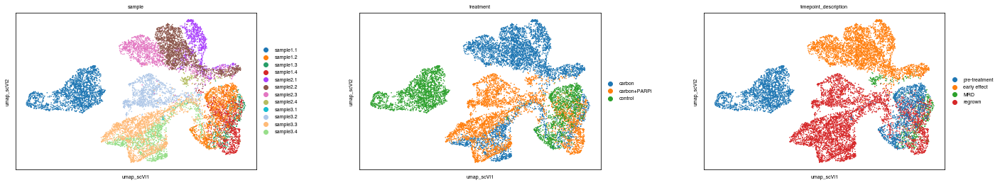

In [29]:
sc.pl.embedding(
    adata_vis,
    basis="umap_scVI",
    color=["sample", "treatment", "timepoint_description"],
    wspace=0.3,
)

In [25]:
adata_vis.write_h5ad(
    os.path.join(run_name, "sp.h5ad"), compression="gzip", compression_opts=9
)

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


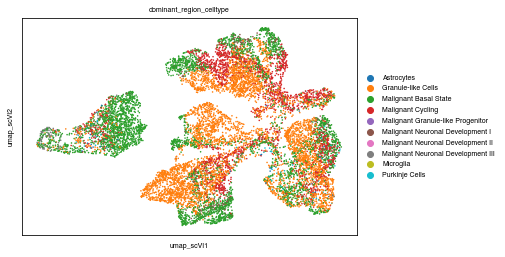

In [30]:
sc.pl.embedding(
    adata_vis,
    basis="umap_scVI",
    color="dominant_region_celltype",
)

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
/home/kats/.local/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


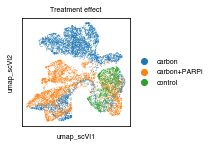

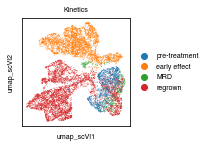

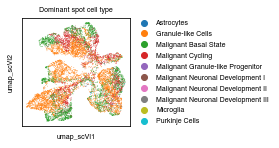

In [31]:
with mpl.rc_context({"figure.figsize": (4, 2)}):
    for var, title in zip(
        ("treatment", "timepoint_description"), ("Treatment effect", "Kinetics")
    ):
        sc.pl.embedding(
            adata_vis[adata_vis.obs["sample"] != "sample1.1"],
            basis="umap_scVI",
            color=var,
            title=title,
            size=2,
            wspace=2,
            show=False,
        )
        plt.gca().set_box_aspect(1)
        plt.savefig(f"figures/6_umap_{var}.svgz")

    sc.pl.embedding(
        adata_vis[adata_vis.obs["sample"] != "sample1.1"],
        basis="umap_scVI",
        color="dominant_region_celltype",
        title="Dominant spot cell type",
        size=2,
        wspace=2,
        show=False,
    )
    plt.gca().set_box_aspect(1)
    plt.savefig("figures/6B.svgz")

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 10 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/6C.svgz
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/pytho

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

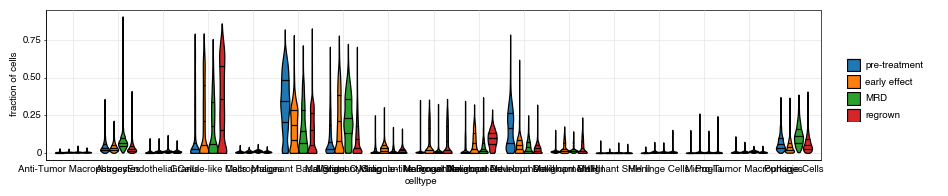

In [34]:
p = (
    ggplot(
        adata_vis.obs[toplot + ["timepoint_description"]]
        .melt(
            id_vars="timepoint_description", var_name="celltype", value_name="fraction"
        )
        .assign(
            celltype=lambda x: pd.Categorical(
                x.celltype,
            )
        )
        .assign(
            group=lambda x: pd.Categorical(
                x.celltype.astype(str) + x.timepoint_description.astype(str),
                categories=np.dstack(
                    np.meshgrid(
                        x.celltype.cat.categories,
                        x.timepoint_description.cat.categories,
                        indexing="ij",
                    )
                )
                .reshape((-1, 2))
                .sum(1),
            )
        ),
        aes("celltype", "fraction", fill="timepoint_description", group="group"),
    )
    + geom_violin(
        scale="width",
        color="black",
        n=4096,
        width=0.8,
        draw_quantiles=[0.25, 0.5, 0.75],
    )
    + scale_fill_manual(
        breaks=adata_vis.obs.timepoint_description.cat.categories,
        values=adata_vis.uns["timepoint_description_colors"],
    )
    + guides(color=guide_legend(override_aes={"size": 3, "alpha": 1}))
    + labs(y="fraction of cells", fill="")
    + theme(aspect_ratio="auto", figure_size=(10, 1.95), axis_ticks_major_x=element_blank())
)
p.save("figures/6C.svgz")
print(p)